In [20]:
import pretty_midi
import numpy as np
import tensorflow as tf

## Import midi & cqt data

In [21]:
path = r"F:\Dataset_open_topic\maestro-v3.0.0_all\maestro-v3.0.0\2018\MIDI-Unprocessed_Chamber3_MID--AUDIO_10_R3_2018_wav--1.midi"
midi_data = pretty_midi.PrettyMIDI(path)
cqt_path = r"F:\Dataset_open_topic\maestro-v3.0.0_all\Processed_data\train2\MIDI-Unprocessed_Chamber3_MID--AUDIO_10_R3_2018_wav--1.wav_0.npy"
cqt = np.load(cqt_path)

midi_duration = midi_data.get_end_time()  # seconds
print(f"MIDI duration: {midi_duration} sec")   

MIDI duration: 703.98046875 sec


## Preprocessing

In [22]:
##### Extract Midi note into segment
segment_duration = 10 # Seconds
num_segments = int(np.ceil(midi_duration / segment_duration))

midi_segments = []

for i in range(num_segments):
    start_time = i * segment_duration
    end_time = (i + 1) * segment_duration

    # Extract MIDI notes in this time range for mapping with CQT segment
    notes_in_segment = []
    for instrument in midi_data.instruments:    # Extract instrument on midi
        for note in instrument.notes:           # note contain : Start time, End time, Pitch, Velocity
            if start_time <= note.start < end_time or start_time < note.start <= end_time:
                notes_in_segment.append((note.pitch, note.start - start_time, note.end - start_time, note.velocity))

    midi_segments.append(notes_in_segment)

print(f"Extracted {len(midi_segments)} MIDI segments")


Extracted 71 MIDI segments


In [23]:
for i in range(len(midi_segments)):
    print(f"Note in segment {i} :", len(midi_segments[i]))


Note in segment 0 : 31
Note in segment 1 : 31
Note in segment 2 : 72
Note in segment 3 : 52
Note in segment 4 : 71
Note in segment 5 : 98
Note in segment 6 : 83
Note in segment 7 : 26
Note in segment 8 : 34
Note in segment 9 : 84
Note in segment 10 : 126
Note in segment 11 : 99
Note in segment 12 : 35
Note in segment 13 : 29
Note in segment 14 : 38
Note in segment 15 : 36
Note in segment 16 : 32
Note in segment 17 : 25
Note in segment 18 : 81
Note in segment 19 : 60
Note in segment 20 : 71
Note in segment 21 : 101
Note in segment 22 : 76
Note in segment 23 : 31
Note in segment 24 : 41
Note in segment 25 : 99
Note in segment 26 : 133
Note in segment 27 : 71
Note in segment 28 : 33
Note in segment 29 : 36
Note in segment 30 : 43
Note in segment 31 : 28
Note in segment 32 : 24
Note in segment 33 : 46
Note in segment 34 : 91
Note in segment 35 : 59
Note in segment 36 : 94
Note in segment 37 : 126
Note in segment 38 : 157
Note in segment 39 : 95
Note in segment 40 : 60
Note in segment 41 : 

In [24]:
def midi_to_pianoroll(midi_notes, segment_length=10, fs=100):
    time_bins = segment_length * fs     # Number of time steps
    pitch_bins = 128                    # MIDI has 128 possible notes

    pianoroll = np.zeros((pitch_bins, time_bins))  

    for pitch, start, end, velo in midi_notes:
        start_bin = int(start * fs)
        end_bin = int(end * fs)
        pianoroll[pitch, start_bin:end_bin] = 1  # Mark active notes

    return pianoroll

# Convert all MIDI segments
pianoroll_labels = [midi_to_pianoroll(segment) for segment in midi_segments]

# Convert to NumPy array for CNN training
pianoroll_labels = np.array(pianoroll_labels)

In [25]:
print("Piano roll size: " ,pianoroll_labels.shape)
print("cqt size: ",cqt.shape)

Piano roll size:  (71, 128, 1000)
cqt size:  (267, 1001)


In [26]:
def create_sliding_windows(cqt, window_size=9, stride=1):
    num_time_bins = cqt.shape[1]  # Time dimension (1000 in your case)    
    windows = np.array([
        cqt[:, i:i + window_size]  # Extract a slice (267, window_size)
        for i in range(0, num_time_bins - window_size + 1, stride)
    ])
    return windows[..., np.newaxis]  # Add channel dimension (for CNN input)

def create_sliding_windows_midi(midi, window_size=9, stride=1):
    num_time_bins = midi.shape[1]  # 1000 time bins
    num_windows = (num_time_bins - window_size) // stride + 1  # Compute number of windows
    windows = np.array([
        midi[:, i:i + window_size]  # Extract slice (128, window_size)
        for i in range(0, num_time_bins - window_size + 1, stride)
    ])
    return windows, num_windows

In [27]:
X_input = create_sliding_windows(cqt[:,:-1], window_size=9, stride=1)  # (num_windows, 267, 9, 1)
print("Sliding Window Output Shape:", X_input.shape)

Y_output, num_windows_midi = create_sliding_windows_midi(pianoroll_labels[0], window_size=9, stride=1)
print("Sliding Window MIDI Output Shape:", Y_output.shape)

Sliding Window Output Shape: (992, 267, 9, 1)
Sliding Window MIDI Output Shape: (992, 128, 9)


In [28]:
Y_output_flattened = np.any(Y_output, axis=2)  # Shape: (n, 128)

In [29]:
print("Xtrain : ",X_input.shape)
print("out : ",Y_output.shape)
print("Ytrain : ",Y_output_flattened.shape)
print("CQT : ", cqt.shape)

Xtrain :  (992, 267, 9, 1)
out :  (992, 128, 9)
Ytrain :  (992, 128)
CQT :  (267, 1001)


### Validate epoching training data from cqt

In [30]:
import numpy as np
import matplotlib.pyplot as plt

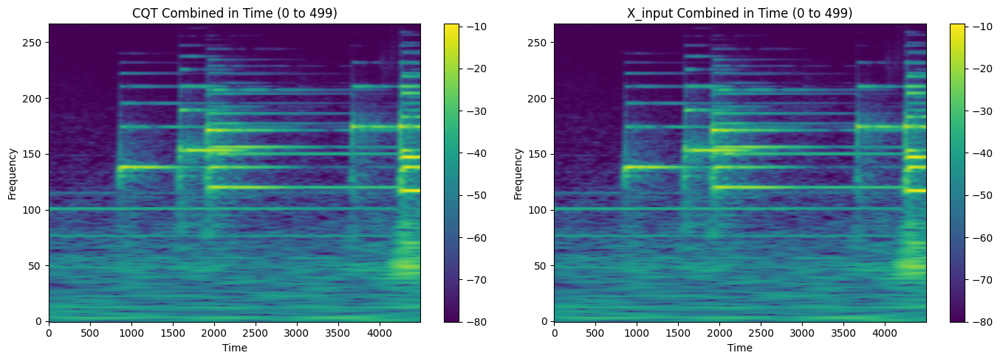

In [31]:
start = 0
end = 500  # number of frames to combine (e.g., 5 → total width = 9 × 5 = 45)

# Collect all cropped CQT slices and X_input samples
cqt_stack = []
xinput_stack = []

for ind in range(start, end):
    cqt_crop = cqt[:, ind:ind+9]           # (267, 9)
    xtrain_sample = X_input[ind, :, :, 0]  # (267, 9)
    
    cqt_stack.append(cqt_crop)
    xinput_stack.append(xtrain_sample)

# Stack along time axis → (267, 9 * N)
cqt_combined = np.hstack(cqt_stack)
xinput_combined = np.hstack(xinput_stack)

# Plot both side-by-side
plt.figure(figsize=(14, 5))

# Left: Combined CQT crops
plt.subplot(1, 2, 1)
plt.imshow(cqt_combined, aspect='auto', origin='lower', cmap='viridis')
plt.title(f'CQT Combined in Time ({start} to {end-1})')
plt.xlabel('Time')
plt.ylabel('Frequency')
plt.colorbar()

# Right: Combined X_input samples
plt.subplot(1, 2, 2)
plt.imshow(xinput_combined, aspect='auto', origin='lower', cmap='viridis')
plt.title(f'X_input Combined in Time ({start} to {end-1})')
plt.xlabel('Time')
plt.ylabel('Frequency')
plt.colorbar()

plt.tight_layout()
plt.show()



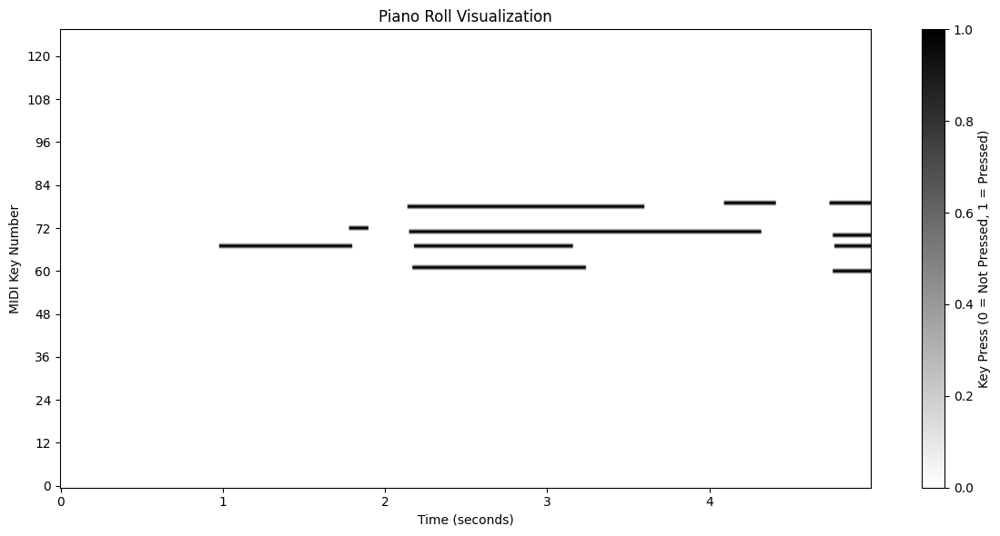

In [32]:
frame_rate = 100  # 100 timesteps per second
max_timesteps = 500

# Time axis computation
time_in_seconds = np.arange(0, max_timesteps / frame_rate, step=1)
timesteps = time_in_seconds * frame_rate
timesteps = timesteps[timesteps < max_timesteps] 

# Plot
plt.figure(figsize=(12, 6))
plt.imshow(pianoroll_labels[0, :, :max_timesteps], aspect='auto', cmap='gray_r', origin='lower')

# Labels
plt.xlabel("Time (seconds)")
plt.ylabel("MIDI Key Number")
plt.title("Piano Roll Visualization")
plt.xticks(timesteps, time_in_seconds[:len(timesteps)].astype(int))
plt.yticks(np.arange(0, 128, step=12))  # One tick per octave

plt.colorbar(label="Key Press (0 = Not Pressed, 1 = Pressed)")
plt.tight_layout()
plt.show()


# Model Construct

In [33]:
num_classes = 128

model = tf.keras.Sequential([
    tf.keras.layers.Conv2D(10, (16, 2), activation='relu', padding='valid', input_shape=(267, 9, 1), name="conv1"),
    tf.keras.layers.MaxPooling2D((2, 2), name="pool1"),
    tf.keras.layers.Conv2D(20, (11, 3), activation='relu', padding='valid', name="conv2"),
    tf.keras.layers.MaxPooling2D((2, 2), name="pool2"),
    tf.keras.layers.Flatten(name="flatten"),
    tf.keras.layers.Dense(256, activation='relu', name="fc1"),
    tf.keras.layers.Dropout(0.5, name="dropout"),
    tf.keras.layers.Dense(num_classes, activation='sigmoid', name="fc2")
])

model.summary()

c:\Users\napat\Documents\GitHub\env\lib\site-packages\keras\src\layers\convolutional\base_conv.py:107: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


Model: "sequential_1"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━┓
┃ Layer (type)                    ┃ Output Shape           ┃       Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━┩
│ conv1 (Conv2D)                  │ (None, 252, 8, 10)     │           330 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ pool1 (MaxPooling2D)            │ (None, 126, 4, 10)     │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2 (Conv2D)                  │ (None, 116, 2, 20)     │         6,620 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ pool2 (MaxPooling2D)            │ (None, 58, 1, 20)      │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ flatten (Flatten)               │ (None, 1160)           │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ fc1 (Dense)                     │ (None, 256)            │       297,216 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dropout (Dropout)               │ (None, 256)            │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ fc2 (Dense)                     │ (None, 128)            │        32,896 │
└─────────────────────────────────┴────────────────────────┴───────────────┘

 Total params: 337,062 (1.29 MB)

 Trainable params: 337,062 (1.29 MB)

 Non-trainable params: 0 (0.00 B)

In [ ]:
model.compile(
    optimizer=tf.keras.optimizers.Adam(learning_rate=0.01),
    loss='categorical_crossentropy',
    metrics=['accuracy']
)

In [35]:
print(X_input.shape)
print(Y_output_flattened.shape)
temp = []
for i in range(len(Y_output_flattened)):
    for j in range(len(Y_output_flattened[i])):
        if (Y_output_flattened[i][j]) == 1:
            temp.append([i,j])
len(temp)

(992, 267, 9, 1)
(992, 128)


2284

In [36]:
model.fit(X_input, Y_output_flattened, epochs=20, batch_size=256,validation_split=0.2)
model.save("piano_model.h5")

Epoch 1/20
4/4 ━━━━━━━━━━━━━━━━━━━━ 1s 83ms/step - accuracy: 0.0015 - loss: 5.3711 - val_accuracy: 0.0000e+00 - val_loss: 0.4041
Epoch 2/20
4/4 ━━━━━━━━━━━━━━━━━━━━ 0s 42ms/step - accuracy: 0.0289 - loss: 0.8300 - val_accuracy: 0.0000e+00 - val_loss: 0.3034
Epoch 3/20
4/4 ━━━━━━━━━━━━━━━━━━━━ 0s 40ms/step - accuracy: 0.0183 - loss: 0.4497 - val_accuracy: 0.0000e+00 - val_loss: 0.2854
Epoch 4/20
4/4 ━━━━━━━━━━━━━━━━━━━━ 0s 43ms/step - accuracy: 0.0158 - loss: 0.3656 - val_accuracy: 0.0000e+00 - val_loss: 0.1997
Epoch 5/20
4/4 ━━━━━━━━━━━━━━━━━━━━ 0s 42ms/step - accuracy: 0.0205 - loss: 0.2773 - val_accuracy: 0.0000e+00 - val_loss: 0.1221
Epoch 6/20
4/4 ━━━━━━━━━━━━━━━━━━━━ 0s 42ms/step - accuracy: 0.0270 - loss: 0.2012 - val_accuracy: 0.0101 - val_loss: 0.0911
Epoch 7/20
4/4 ━━━━━━━━━━━━━━━━━━━━ 0s 42ms/step - accuracy: 0.0362 - loss: 0.1595 - val_accuracy: 0.0101 - val_loss: 0.0916
Epoch 8/20
4/4 ━━━━━━━━━━━━━━━━━━━━ 0s 39ms/step - accuracy: 0.0779 - loss: 0.1320 - val_accuracy: 0.0101

In [37]:
model = tf.keras.models.load_model("piano_model.h5")

In [38]:
predict = model.predict(X_input)
print("Output size : ", predict.shape)

31/31 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
Output size :  (992, 128)


In [39]:
predict[:5]

array([[5.37739033e-05, 1.14328031e-04, 7.26309008e-05, 1.24953498e-04,
        2.25336174e-04, 3.60452948e-04, 1.36724397e-04, 5.18673914e-04,
        4.83858603e-05, 6.68278881e-05, 3.73603471e-05, 1.21568781e-04,
        3.88832093e-04, 2.55302730e-04, 8.64142348e-05, 3.82448670e-05,
        2.88793090e-05, 7.52125168e-04, 5.11905237e-04, 2.11588649e-05,
        5.82458670e-05, 3.36806057e-04, 7.06142819e-05, 1.69951309e-04,
        5.51729521e-04, 2.49522360e-04, 6.00105013e-05, 6.17030018e-05,
        5.38906024e-04, 1.25638820e-04, 5.86401671e-04, 7.68968966e-05,
        2.88908523e-05, 2.54136594e-05, 6.68178371e-04, 8.96181336e-06,
        1.38219493e-03, 7.04263803e-05, 3.94213770e-04, 1.33358320e-04,
        1.97800764e-04, 1.75843506e-05, 1.71951868e-03, 8.74276884e-05,
        2.63539441e-05, 1.43030938e-03, 5.35483377e-05, 8.84795154e-05,
        4.44582460e-04, 1.71778942e-04, 1.09118002e-04, 3.00189917e-04,
        6.14417542e-04, 1.78019400e-04, 2.57564243e-04, 3.283888

In [40]:
from mido import MidiFile, MidiTrack, Message
midi = MidiFile()
track = MidiTrack()
midi.tracks.append(track)
fixed_velo = 100
n_time_step = predict.shape[0]
time_interval = int((time_duration/n_time_step) * 1000) # c
time_interval
for timestep in predict:
    for key, state in enumerate(timestep):
        # print(key,state)
        if state == 1 :
            track.append(Message('note_on', channel=1, note=key, velocity=fixed_velo, time=0))
        else:
            track.append(Message('note_off', channel=1, note=key, velocity=0, time=0))
        track.append(Message('note_off', channel=1, note=0, velocity=0, time=time_interval))

NameError: name 'time_duration' is not defined

In [ ]:
midi

MidiFile(type=1, ticks_per_beat=480, tracks=[
  MidiTrack([
    Message('note_off', channel=1, note=0, velocity=0, time=0),
    Message('note_off', channel=1, note=0, velocity=0, time=10),
    Message('note_off', channel=1, note=1, velocity=0, time=0),
    Message('note_off', channel=1, note=0, velocity=0, time=10),
    Message('note_off', channel=1, note=2, velocity=0, time=0),
    Message('note_off', channel=1, note=0, velocity=0, time=10),
    Message('note_off', channel=1, note=3, velocity=0, time=0),
    Message('note_off', channel=1, note=0, velocity=0, time=10),
    Message('note_off', channel=1, note=4, velocity=0, time=0),
    Message('note_off', channel=1, note=0, velocity=0, time=10),
    Message('note_off', channel=1, note=5, velocity=0, time=0),
    Message('note_off', channel=1, note=0, velocity=0, time=10),
    Message('note_off', channel=1, note=6, velocity=0, time=0),
    Message('note_off', channel=1, note=0, velocity=0, time=10),
    Message('note_off', channel=1, no

In [ ]:
midi.save('output.mid')

In [ ]:
midi

MidiFile(type=1, ticks_per_beat=480, tracks=[
  MidiTrack([
    Message('note_off', channel=1, note=0, velocity=0, time=0),
    Message('note_off', channel=1, note=0, velocity=0, time=10),
    Message('note_off', channel=1, note=1, velocity=0, time=0),
    Message('note_off', channel=1, note=0, velocity=0, time=10),
    Message('note_off', channel=1, note=2, velocity=0, time=0),
    Message('note_off', channel=1, note=0, velocity=0, time=10),
    Message('note_off', channel=1, note=3, velocity=0, time=0),
    Message('note_off', channel=1, note=0, velocity=0, time=10),
    Message('note_off', channel=1, note=4, velocity=0, time=0),
    Message('note_off', channel=1, note=0, velocity=0, time=10),
    Message('note_off', channel=1, note=5, velocity=0, time=0),
    Message('note_off', channel=1, note=0, velocity=0, time=10),
    Message('note_off', channel=1, note=6, velocity=0, time=0),
    Message('note_off', channel=1, note=0, velocity=0, time=10),
    Message('note_off', channel=1, no